In [1]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import clear_output
plt.style.use("dark_background")

In [417]:
"""
Constants and paramters
"""


L = 64
N = 100
r_cutoff = 4
dt = 1
v0 = 1
eta = 0.3
# Each row of particles contains x, y, theta for each particle
# Speed v0 is the same for all. so only the direction theta matters.
particles = np.zeros(shape=(3, N))

In [418]:
def initialize_system(particles, seed=1327):
    np.random.seed(seed)
    particles[0] = np.random.uniform(low=0, high=L, size=N)
    particles[1] = np.random.uniform(low=0, high=L, size=N)
    particles[2] = np.random.uniform(low=-np.pi, high=np.pi, size=N)


def relative_distances(particles):
    # Apllies Minimum Image Convention and computes the pairwise distances between particles.
    positions = np.transpose(particles[0:2])
    # A numpy broadcasting trick to avoid using for loops.
    # (i,j,k) shows the difference between
    # the k'th coordinate of particle i and
    # the k'th coordinate of particle j.
    r_ij = positions[:, np.newaxis, :] - positions[np.newaxis, :, :]
    # I don't fully understand the next line but a similar line was there in all the
    # examples I studied on the internet. It is needed for the function to work properly.
    r_ij = r_ij - np.round(r_ij / L) * L
    # Basically ternary condition for applying MIC:
    r_ij = np.where((np.abs(r_ij) > 0.5 * L), (r_ij - np.sign(r_ij) * L), r_ij)
    # The matrix of distances:
    r_ij = np.sqrt(np.sum(np.square(r_ij), axis=2))
    # Apply cut-off ternary conditions:
    r_ij = np.where(r_ij<r_cutoff, 1, np.nan)
    return r_ij


def vicsek_step(particles, eta=0.1):
    white_noise = np.random.uniform(low=-np.pi, high=np.pi, size=N)
    # Periodic Boundary Condition Check:
    particles[0:2] = (particles[0:2]+L) % L

    r_ij = relative_distances(particles)
    # The theta array is updated:
    particles[2] = np.nanmean(particles[2] * r_ij, axis=1) + eta * white_noise
    # The x and y arrays are updated:
    particles[0] += v0 * np.cos(particles[2]) * dt
    particles[1] += v0 * np.sin(particles[2]) * dt
    
    # Periodic Boundary Condition Check:
    particles[0:2] = (particles[0:2]+L) % L

$\Large Animation$

In [443]:
# Takes 11 seconds.
plt.rcParams["animation.html"] = "jshtml"

# The parameters:
L = 64
N = 400
r_cutoff = 4
dt = 1
v0 = 1
eta = 0.3
particles = np.zeros(shape=(3, N))



# Initiating the plot:
fig, ax = plt.subplots(figsize=(6,6))
ax.set_xlim((-1, L+1))
ax.set_ylim((-1, L+1))

initialize_system(particles, seed=260)
# Create an empty points object with no data.
# It will be updated during each frame of the animation.
points = ax.quiver(particles[0], particles[1], np.cos(particles[2]), np.sin(particles[2]), particles[2])

# initialization function: plot the background of each frame.
# There was a similar function in all the example codes I studied; must be the standard way!
def init():
    points.set_offsets(particles[0:2].T)
    points.set_UVC(np.cos(particles[2]), np.sin(particles[2]), particles[2])
    return points,


# The animation function. This is called sequentially.
def animate(i):
    # Adjusting for the first frame:
    if i==0:
        initialize_system(particles, seed=260)
        ax.set_title(f"$\eta$ = {eta} ; $L = {L}$ ; $N = {N}$\nTime = {i}")
        vicsek_step(particles, eta=eta)
        points.set_offsets(particles[0:2].T)
        points.set_UVC(np.cos(particles[2]), np.sin(particles[2]), particles[2])
        return points,
    ax.set_title(f"$\eta$ = {eta} ; $L = {L}$ ; $N = {N}$\nTime = {i}")
    vicsek_step(particles, eta=eta)
    points.set_offsets(particles[0:2].T)
    points.set_UVC(np.cos(particles[2]), np.sin(particles[2]), particles[2])
    return points,


# Finally moving on to the animator function.
# blit=True means only re-draw the parts that have changed; this helps increase the speed of the program.
anim = animation.FuncAnimation(fig, animate, init_func=init, frames=301, blit=True)
plt.close("all")
anim

Animation size has reached 21043823 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [444]:
# Saving the animation in mp4:
# Takes up to 22 seconds.
dpi = 300
writer = animation.writers["ffmpeg"](fps=10)
anim.save("Animation_eta03_N400.mp4",writer=writer,dpi=dpi)

$\Large Phase \ Transition \ for \ Fixed \ Density \ of \ 0.03$

$\Large L = 32$

In [447]:
num_etas = 50
different_etas = np.linspace(start=0.0, stop=0.8, num=num_etas)
phi_L32 = np.zeros(len(different_etas))
# fixed_density = 0.03
L = 32
N = 31
r_cutoff = 4
v0 = 1
dt = 1
num_iter = 500
particles = np.zeros(shape=(3, N))
for i in range(num_etas):
    print((i+1)/num_etas*100, " %")
    phi_iter = np.zeros((num_iter,1))
    initialize_system(particles, seed=34)
    for t in range(num_iter):
        vicsek_step(particles, eta=different_etas[i])
        phi_iter[t] = np.sqrt((np.sum(np.cos(particles[2])))**2+(np.sum(np.sin(particles[2])))**2) / N
    phi_L32[i] = np.mean(phi_iter)
    clear_output(wait=True)

100.0  %


$\Large L = 64$

In [360]:
# Takes 30 seconds.
num_etas = 50
different_etas = np.linspace(start=0.0, stop=0.8, num=num_etas)
phi_L64 = np.zeros(len(different_etas))
# fixed_density = 0.03
L = 64
N = 125
r_cutoff = 4
v0 = 1
dt = 1
num_iter = 500
particles = np.zeros(shape=(3, N))
for i in range(num_etas):
    print((i+1)/num_etas*100, " %")
    phi_iter = np.zeros((num_iter,1))
    initialize_system(particles, seed=34)
    for t in range(num_iter):
        vicsek_step(particles, eta=different_etas[i])
        phi_iter[t] = np.sqrt((np.sum(np.cos(particles[2])))**2+(np.sum(np.sin(particles[2])))**2) / N
    phi_L64[i] = np.mean(phi_iter)
    clear_output(wait=True)

100.0  %


$\Large L = 80$

In [368]:
# Takes 1 minute 16 seconds.
num_etas = 50
different_etas = np.linspace(start=0.0, stop=0.8, num=num_etas)
phi_L80 = np.zeros(len(different_etas))
# fixed_density = 0.03
L = 80
N = 195
r_cutoff = 4
v0 = 1
dt = 1
num_iter = 500
particles = np.zeros(shape=(3, N))
for i in range(num_etas):
    print((i+1)/num_etas*100, " %")
    phi_iter = np.zeros((num_iter,1))
    initialize_system(particles, seed=34)
    for t in range(num_iter):
        vicsek_step(particles, eta=different_etas[i])
        phi_iter[t] = np.sqrt((np.sum(np.cos(particles[2])))**2+(np.sum(np.sin(particles[2])))**2) / N
    phi_L80[i] = np.mean(phi_iter)
    clear_output(wait=True)

100.0  %


$\Large L = 128$

In [369]:
# Takes 11 minutes.
num_etas = 50
different_etas = np.linspace(start=0.0, stop=0.8, num=num_etas)
phi_L128 = np.zeros(len(different_etas))
# fixed_density = 0.03
L = 128
N = 500
r_cutoff = 4
v0 = 1
dt = 1
num_iter = 500
particles = np.zeros(shape=(3, N))
for i in range(num_etas):
    print((i+1)/num_etas*100, " %")
    phi_iter = np.zeros((num_iter,1))
    initialize_system(particles, seed=34)
    for t in range(num_iter):
        vicsek_step(particles, eta=different_etas[i])
        phi_iter[t] = np.sqrt((np.sum(np.cos(particles[2])))**2+(np.sum(np.sin(particles[2])))**2) / N
    phi_L128[i] = np.mean(phi_iter)
    clear_output(wait=True)

100.0  %


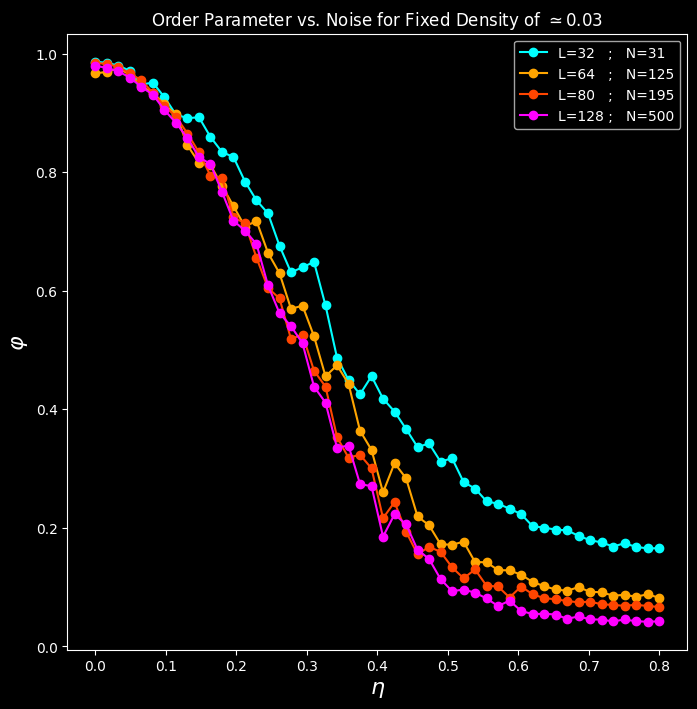

In [448]:
fig, ax = plt.subplots(figsize=(8,8))
ax.plot(different_etas, phi_L32, marker="o", color="aqua", label="L=32   ;   N=31")
ax.plot(different_etas, phi_L64, marker="o", color="orange", label="L=64   ;   N=125")
ax.plot(different_etas, phi_L80, marker="o", color="orangered", label="L=80   ;   N=195")
ax.plot(different_etas, phi_L128, marker="o", color="magenta", label="L=128 ;   N=500")
ax.set_title("Order Parameter vs. Noise for Fixed Density of $\simeq 0.03$")
ax.set_xlabel("$\eta$", fontsize=16)
ax.set_ylabel("$\\varphi$", fontsize=16)
ax.legend();

In [449]:
# fig.savefig("phi_vs_eta.jpg")

$\Large Phase \ Transition \ for \ Different \ Values \ of \ v_0$

In [410]:
# Takes 60 seconds.
num_etas = 20
different_etas = np.linspace(start=0.0, stop=0.8, num=num_etas)
different_vs = np.array([0, 2, 4, 5, 10])
# phi for differnet values of v0 and eta:
phi_vs = np.zeros((len(different_etas), len(different_vs)))
# fixed_density = 0.03
L = 64
N = 125
r_cutoff = 4
dt = 1
num_iter = 500
particles = np.zeros(shape=(3, N))
for j in range(len(different_vs)):
    for i in range(num_etas):
        print((i+1)/num_etas*100, " %")
        phi_iter = np.zeros((num_iter,1))  # phi for each vicsek iteration
        initialize_system(particles, seed=1327)
        for t in range(num_iter):
            vicsek_step(particles, eta=different_etas[i])
            phi_iter[t] = np.sqrt((np.sum(np.cos(particles[2])))**2+(np.sum(np.sin(particles[2])))**2) / N
        phi_vs[i, j] = np.mean(phi_iter)
        clear_output(wait=True)

100.0  %


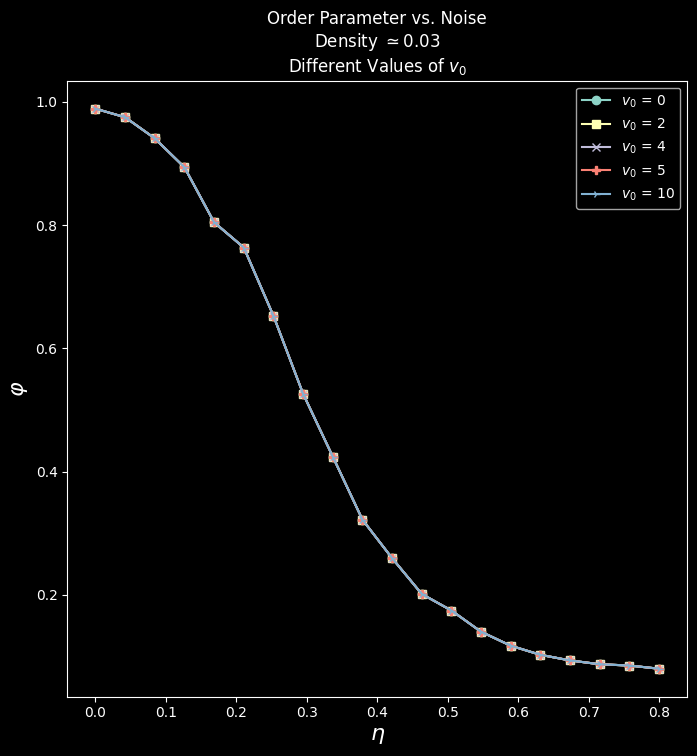

In [452]:
fig, ax = plt.subplots(figsize=(8,8))
ax.plot(different_etas, phi_vs[:, 0], marker="o", label=f"$v_0$ = {different_vs[0]}")
ax.plot(different_etas, phi_vs[:, 1], marker="s", label=f"$v_0$ = {different_vs[1]}")
ax.plot(different_etas, phi_vs[:, 2], marker="x", label=f"$v_0$ = {different_vs[2]}")
ax.plot(different_etas, phi_vs[:, 3], marker="P", label=f"$v_0$ = {different_vs[3]}")
ax.plot(different_etas, phi_vs[:, 4], marker="4", label=f"$v_0$ = {different_vs[4]}")
ax.set_title("Order Parameter vs. Noise\nDensity $\simeq 0.03$\nDifferent Values of $v_0$")
ax.set_xlabel("$\eta$", fontsize=16)
ax.set_ylabel("$\\varphi$", fontsize=16)
ax.legend();

In [453]:
# fig.savefig("phi_vs_eta_different_vs.jpg")